In [ ]:
#This file contains the basic backbone of Liana code.
#A colorectal cancer dataset (from https://doi.org/10.1038/s41588-020-0636-z)(GSE132465) is used. The dataset has annotation data. It contains data for tumor and mucosal normal samples. the data is not normalized. 
#In this code we first run only cellphonedb method, make dot plot and then rum the aggregate (consensus) method with the dotplot. 

In [59]:
pip install liana

Note: you may need to restart the kernel to use updated packages.


In [6]:
# import liana
import liana as li
# needed for visualization and toy data
import scanpy as sc
#AnnData needed for single cell data analysis
import anndata

In [9]:
file_path = "/home/guest/Disha/Practice codes/colonscseq.h5ad"
adata = anndata.read_h5ad(file_path)

/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.


In [10]:
adata

AnnData object with n_obs × n_vars = 63689 × 33694
    obs: 'Index', 'Patient', 'Class', 'Sample', 'Cell_type', 'Cell_subtype'
    uns: 'Cell_type_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'pca', 'umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


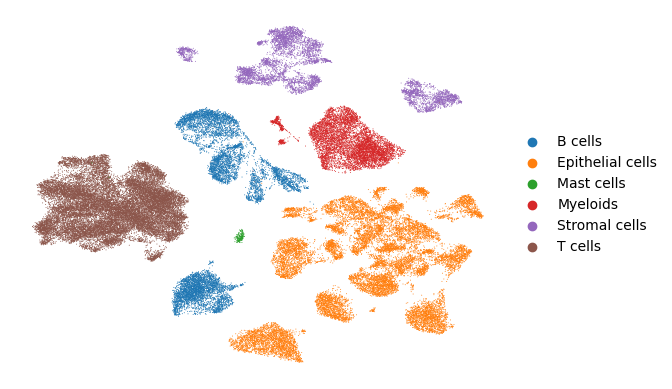

In [11]:
sc.pl.umap(adata, color='Cell_type', title='', frameon=False)

In [18]:
adata.raw = adata.copy()

In [19]:
adata.raw.X

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.22504988, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

In [13]:
li.mt.show_methods()

,Method Name,Magnitude Score,Specificity Score,Reference
0,CellPhoneDB,lr_means,cellphone_pvals,"Efremova, M., Vento-Tormo, M., Teichmann, S.A...."
0,Connectome,expr_prod,scaled_weight,"Raredon, M.S.B., Yang, J., Garritano, J., Wang..."
0,log2FC,None,lr_logfc,"Dimitrov, D., Türei, D., Garrido-Rodriguez, M...."
0,NATMI,expr_prod,spec_weight,"Hou, R., Denisenko, E., Ong, H.T., Ramilowski,..."
0,SingleCellSignalR,lrscore,None,"Cabello-Aguilar, S., Alame, M., Kon-Sun-Tack, ..."
0,CellChat,lr_probs,cellchat_pvals,"Jin, S., Guerrero-Juarez, C.F., Zhang, L., Cha..."
0,Rank_Aggregate,magnitude_rank,specificity_rank,"Dimitrov, D., Türei, D., Garrido-Rodriguez, M...."
0,Geometric Mean,lr_gmeans,gmean_pvals,CellPhoneDBv2's permutation approach applied t...


In [14]:
# import liana's rank_aggregate
from liana.mt import rank_aggregate

In [9]:
?rank_aggregate.__call__

In [10]:
rank_aggregate.describe()

Rank_Aggregate returns `magnitude_rank`, `specificity_rank`.magnitude_rank and specificity_rank respectively represent an aggregate of the `magnitude`- and `specificity`-related scoring functions from the different methods.


In [15]:
li.resource.show_resources()

['baccin2019',
 'cellcall',
 'cellchatdb',
 'cellinker',
 'cellphonedb',
 'celltalkdb',
 'connectomedb2020',
 'consensus',
 'embrace',
 'guide2pharma',
 'hpmr',
 'icellnet',
 'italk',
 'kirouac2010',
 'lrdb',
 'mouseconsensus',
 'ramilowski2015']

In [16]:
# import all individual methods
from liana.method import singlecellsignalr, connectome, cellphonedb, natmi, logfc, cellchat, geometric_mean

In [20]:
# run cellphonedb
cellphonedb(adata, groupby='Cell_type', expr_prop=0.1, verbose=True, key_added='cpdb_res')

Using `.raw`!
Converting mat to CSR format
5741 features of mat are empty, they will be removed.


/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/pandas/core/indexing.py:1761: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


0.06 of entities in the resource are missing from the data.
Generating ligand-receptor stats for 63689 samples and 27953 features


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:58<00:00, 17.11it/s]


In [21]:
# by default, liana's output is saved in place:
adata.uns['cpdb_res'].head()

,ligand,ligand_complex,ligand_means,ligand_props,receptor,receptor_complex,receptor_means,receptor_props,source,target,lr_means,cellphone_pvals
7141,B2M,B2M,4.495886,0.999957,CD3D,CD3D,1.599591,0.861172,T cells,T cells,3.047739,0.0
6802,B2M,B2M,4.006661,1.000000,CD3D,CD3D,1.599591,0.861172,Myeloids,T cells,2.803126,0.0
7035,B2M,B2M,3.719803,0.999831,CD3D,CD3D,1.599591,0.861172,Stromal cells,T cells,2.659697,0.0
6684,B2M,B2M,3.685851,1.000000,CD3D,CD3D,1.599591,0.861172,Mast cells,T cells,2.642721,0.0
1407,TPSB2,TPSB2,5.009038,1.000000,F2RL1,F2RL1,0.156072,0.478073,Mast cells,Epithelial cells,2.582555,0.0


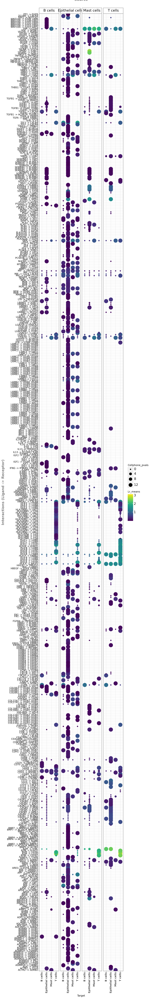

<Figure Size: (900 x 6000)>

In [45]:
cellphone_plot=li.pl.dotplot(adata = adata,
              colour='lr_means',
              size='cellphone_pvals',
              inverse_size=True, # we inverse sign since we want small p-values to have large sizes
              source_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells'],
              target_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells'],
              figure_size=(9, 60),
              # finally, since cpdbv2 suggests using a filter to FPs
              # we filter the pvals column to <= 0.05
              filterby='cellphone_pvals',
              filter_lambda=lambda x: x <= 0.05,
              uns_key='cpdb_res' # uns_key to use, default is 'liana_res'
             )
cellphone_plot

In [48]:
cellphone_plot.save('dotplot.pdf', limitsize=False)

/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 9 x 60 in image.
/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: dotplot.pdf


In [29]:
# Run rank_aggregate
li.mt.rank_aggregate(adata, groupby='Cell_type', expr_prop=0.1, verbose=True)

Using `.raw`!
Converting mat to CSR format
5741 features of mat are empty, they will be removed.


/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/pandas/core/indexing.py:1761: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


0.06 of entities in the resource are missing from the data.
Generating ligand-receptor stats for 63689 samples and 27953 features
Assuming that counts were `natural` log-normalized!
Running CellPhoneDB


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:32<00:00, 30.56it/s]


Running Connectome
Running log2FC
Running NATMI
Running SingleCellSignalR
Running CellChat


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [26:37<00:00,  1.60s/it]


In [30]:
adata.uns['liana_res'].head()

,source,target,ligand_complex,receptor_complex,lr_means,cellphone_pvals,expr_prod,scaled_weight,lr_logfc,spec_weight,lrscore,lr_probs,cellchat_pvals,specificity_rank,magnitude_rank
6504,T cells,T cells,B2M,CD3D,3.047739,0.0,7.191581,0.968050,2.122818,0.192972,0.982607,0.189608,0.0,0.050478,2.019085e-10
6199,Myeloids,T cells,B2M,CD3D,2.803126,0.0,6.409021,0.741970,1.433509,0.171974,0.981594,0.171984,0.0,0.050478,1.614986e-09
6089,Mast cells,T cells,B2M,CD3D,2.642721,0.0,5.895855,0.593724,1.203336,0.158204,0.980825,0.162505,0.0,0.050478,5.449626e-09
6401,Stromal cells,T cells,B2M,CD3D,2.659697,0.0,5.950165,0.609416,1.214263,0.159661,0.980911,0.161795,0.0,0.050478,1.291537e-08
5846,B cells,T cells,B2M,CD3D,2.483921,0.0,5.387824,0.446957,0.970107,0.144572,0.979959,0.149553,0.0,0.056143,2.522093e-08


In [40]:
li.pl.dotplot(adata = adata,
              colour='magnitude_rank',
              size='specificity_rank',
              inverse_size=True,
              inverse_colour=True,
              source_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells', 'Myeloids', 'Stromal cells'],
              target_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells', 'Myeloids', 'Stromal cells'],
              #top_n=10,
              orderby='magnitude_rank',
              orderby_ascending=True,
              figure_size=(12, 132)  
             )

<Figure Size: (1200 x 13200)>

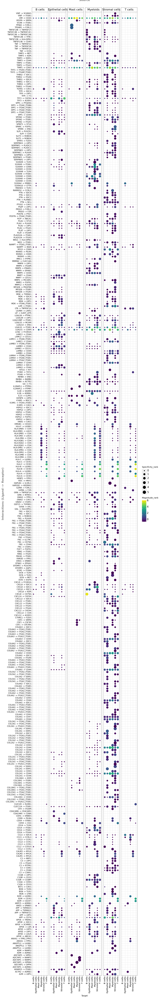

<Figure Size: (1200 x 7500)>

In [53]:
#filtering out only the ones having pvalue<=0.05
my_plot = li.pl.dotplot(adata = adata,
                        colour='magnitude_rank',
                        inverse_colour=True,
                        size='specificity_rank',
                        inverse_size=True,
                        source_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells', 'Myeloids', 'Stromal cells'],
                        target_labels=['B cells', 'Epithelial cells', 'Mast cells', 'T cells', 'Myeloids', 'Stromal cells'],
                        filterby='specificity_rank',
                        filter_lambda=lambda x: x <= 0.05,
                        figure_size=(12, 75),
                       )
my_plot

In [54]:
my_plot.save('aggregate.pdf', limitsize=False)

/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 75 in image.
/home/guest/miniconda3/envs/lianaproject/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: aggregate.pdf
